# Import the data to drive

In [ ]:
# https://drive.google.com/file/d/1bS49TML9N4zFPewm6tXzXCUnSDp_5e-d/view?usp=share_link
#!gdown --id 1GpATd_pM4mcnWWIs28-s1lgqdAg2Wdv-
#!gdown --id 1pGd5tLwA30M7wkbJKdXHaae9tYVDICJ_

from google.colab import drive
drive.mount('/content/drive')
!cp /content/drive/MyDrive/AAIC_Assignments/21_LSTM_Assignment/preprocessed_data.csv ./
!cp /content/drive/MyDrive/AAIC_Assignments/21_LSTM_Assignment/glove_vectors ./

Mounted at /content/drive


In [ ]:
!ls -lh

total 241M
drwx------ 5 root root 4.0K Feb 21 14:53 drive
-rw------- 1 root root 122M Feb 21 14:54 glove_vectors
-rw------- 1 root root 119M Feb 21 14:54 preprocessed_data.csv
drwxr-xr-x 1 root root 4.0K Feb 17 19:30 sample_data


# Importing libraries

In [ ]:
import tensorflow as tf

# import tensorflow_addons as tfa
from tensorflow.keras.layers import LSTM, Flatten, Input, Dense, concatenate, Dropout, Embedding, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from tensorflow.keras.callbacks import TensorBoard, LearningRateScheduler, LambdaCallback
from tensorflow.keras import backend as K

import os
import datetime

from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt


## <font color='red'> Model-1 </font>
We will build and train a deep neural network as shown below

<img src='https://i.imgur.com/w395Yk9.png'>
ref: https://i.imgur.com/w395Yk9.png

___
* __Input_seq_total_text_data__ --- Give Total text data columns as input. We are going to use an Embedding layer to get word vectors. We are also goinf to use predefined glove word vectors, and not train any word vectors. After this we will LSTM on the text data and get the LSTM output. Flatten that output and pass it to the next layers.
___

* __Input_school_state__ --- Give 'school_state' column as input to embedding layer and Train the Keras Embedding layer.
___

* __Project_grade_category__  --- Give 'project_grade_category' column as input to embedding layer and Train the Keras Embedding layer.
___

* __Input_clean_categories__ --- Give 'input_clean_categories' column as input to embedding layer and Train the Keras Embedding layer.
___

* __Input_clean_subcategories__ --- Give 'input_clean_subcategories' column as input to embedding layer and Train the Keras Embedding layer.
___

* __Input_clean_subcategories__ --- Give 'input_teacher_prefix' column as input to embedding layer and Train the Keras Embedding layer.
___

* __Input_remaining_teacher_number_of_previously_posted_projects._resource_summary_contains_numerical_digits._price._quantity__ --- concatenate remaining columns and add a Dense layer after that. 
___


# For reference:
### 1. Using predefined Embedding values in Embedding layer - https://machinelearningmastery.com/use-word-embedding-layers-deep-learning-keras/
### 2. how to give multiple inputs -  https://keras.io/getting-started/functional-api-guide/ 

# <font color='red'> Model-1 </font>

In [ ]:
#read the csv file
df = pd.read_csv('preprocessed_data.csv')

# Seperate the x
y = df['project_is_approved']
df.drop(['project_is_approved'], inplace=True, axis=1)
len(df)

109248

In [ ]:
df.head()

,school_state,teacher_prefix,project_grade_category,teacher_number_of_previously_posted_projects,clean_categories,clean_subcategories,essay,price
0,ca,mrs,grades_prek_2,53,math_science,appliedsciences health_lifescience,i fortunate enough use fairy tale stem kits cl...,725.05
1,ut,ms,grades_3_5,4,specialneeds,specialneeds,imagine 8 9 years old you third grade classroo...,213.03
2,ca,mrs,grades_prek_2,10,literacy_language,literacy,having class 24 students comes diverse learner...,329.00
3,ga,mrs,grades_prek_2,2,appliedlearning,earlydevelopment,i recently read article giving students choice...,481.04
4,wa,mrs,grades_3_5,2,literacy_language,literacy,my students crave challenge eat obstacles brea...,17.74


In [ ]:
# perform stratified train test split on the dataset
X_train, X_test, y_train, y_test = train_test_split(df, y, stratify=y, random_state=30, test_size=0.10)

## 1.1 Text Vectorization

In [ ]:
# ************************************ TOKENIZATION ************************************
# Get the maximum length of the essay feature, this will be the input dimension in the network

# This will be required for padding
input_text_dim = max([len(x.split(' ')) for x in X_train['essay']])

oov_token = '<UNK>'          # Defining an oov token to be used for words that are not in train data but present in test data

# Initialize the tokenizer and fit it to the train data essays
essay_tokenizer = Tokenizer(oov_token=oov_token)
essay_tokenizer.fit_on_texts(X_train['essay'])

# get the word indices for each word, this will be useful when using the predefined glove vectors
word_index = essay_tokenizer.word_index

# Convert the train essay to sequence of numbers using the tokenizer 
train_essay_sequences = essay_tokenizer.texts_to_sequences(X_train['essay'])
test_essay_sequences = essay_tokenizer.texts_to_sequences(X_test['essay'])

# Now pad the train and test essay sequences, so that all the data points have same length
train_padded = pad_sequences(train_essay_sequences, padding='post', truncating='post', maxlen=input_text_dim)
train_padded = np.array(train_padded)

test_padded = pad_sequences(test_essay_sequences, padding='post', truncating='post', maxlen=input_text_dim)
test_padded = np.array(test_padded)


In [ ]:
len(essay_tokenizer.word_docs)

54020

In [ ]:
# print shapes of padded train and test text
print(train_padded.shape)
print(test_padded.shape)

(98323, 339)
(10925, 339)


In [ ]:
# print vocab size and the dimension of the input text
vocab_size = len(word_index) + 1
print(vocab_size, input_text_dim)

54022 339


In [ ]:
# load the glove vectors
from tqdm import tqdm
import pickle

with open('glove_vectors', 'rb') as f:
    glove_model = pickle.load(f)
    glove_words = set(glove_model.keys())

In [ ]:
# Initializing the embedding matrix
emb_text_dim = 300        # The dimension of the embedded text
text_embedding_matrix = np.zeros((vocab_size, emb_text_dim))   # vocab size for the number of rows and 300 as the number of columns

# Now we need to store each of the glove vectors
for word, i in tqdm(word_index.items()):
 embedding_vector = glove_model.get(word)
 if embedding_vector is not None:
   text_embedding_matrix[i] = embedding_vector

100%|██████████| 54021/54021 [00:00<00:00, 352675.33it/s]


In [ ]:
# Defining the embedding layer for the text data and setting the trainable parameter as False
essay_embedding = Embedding(input_dim=vocab_size, output_dim=emb_text_dim, weights=[text_embedding_matrix], input_length=input_text_dim, name='Emb_Text_data', trainable=False)


## 1.2 Categorical feature Vectorization

In [ ]:
# print all the column names
print(df.columns)

Index(['school_state', 'teacher_prefix', 'project_grade_category',
       'teacher_number_of_previously_posted_projects', 'clean_categories',
       'clean_subcategories', 'essay', 'price'],
      dtype='object')


## General function for tokenizing arrays


In [ ]:
def tokenizer_embedder(train_data,test_data, max_num_words,maxlen, embedding_dimension,name,seed=100, filters_to_keep=None,padding=(False,'post', 'post'), oov_token='<UNK>'):
  '''
  Give a stream of data this function returns the embedded matrix after tokenizing the data
  Inputs:
        train_data : The data stream that you want to tokenize and fit the tokenizer to
        test_data : The data stream that you want to tokenize as the test data
        num_words : The maximum number of words in each row of the data stream.
        embedding_dimension : The column dimension of the output embedding martrix
        seed : Value to replicate the same results
        filters_to_keep : The "list" filters to be included/kept while tokenizing the text data.
                  This is iniitally set to None, meaning all the filters will be removed as done by tensorflow.
                  If required we can pass the special characters we want to keep.
                  Eg: If we want to keep '_' in the words we have to pass the following
                  filters_to_keep='_'
        padding : A tuple input. 
                  (padding is required, type of padding, trunc_type) 
                  This is required if we need to pad the output sequences.
                  By default this is set to false.
        oov_token : The out of vocabulary token to be used. Default : "<UNK>"
  Outputs :
        Returns tokenizer, sequences, embedding
        tokenizer : This contains the tokenizer instance fit to the 'data' passed
        train_sequences : return the train tokenized sequences
        test_sequences : return the test tokenized sequences
        embedding : returns an embeddin for the given data
  '''

  # Filters to be removed : Taken form tensorflow
  filters = '!"#$%&()*+,-./:;<=>?@[\\]^_`{|}~\t\n'

  # remove the filters to keep from filters
  if filters_to_keep!=None:
    filters = [x for x in filters]
    for t in filters_to_keep:
      filters.remove(t)
    filters = ''.join(filters)

  # Tokenize the data
  tokenizer = Tokenizer(num_words=max_num_words, oov_token=oov_token, filters=filters)
  tokenizer.fit_on_texts(train_data)

  # Converting the unique data elements to numbers and storing them
  train_sequences = tokenizer.texts_to_sequences(train_data)
  test_sequences = tokenizer.texts_to_sequences(test_data)

  # Store the indexing
  index = tokenizer.word_index

  # count the unique number of school states
  count = len(index) + 1

  # Now we create an embedding matrix
  embedding = Embedding(count, embedding_dimension, input_length=max_num_words,embeddings_initializer=tf.keras.initializers.he_normal(seed=seed),
                        name=name)
  # embedding = Embedding(count, embedding_dimension, input_length=max_num_words,embeddings_initializer=tf.keras.initializers.RandomNormal(mean=0, stddev=1,seed=seed),
  #                       name=name)


  # Now we need to return the tokenizer, train_sequences, test_sequences and the embedded matrix
  # we will return these as tf.data slices so that its easy to send as input
  if padding[0]:
    
    train_padded_sequences =  pad_sequences(train_sequences, padding=padding[1], truncating=padding[2], maxlen=maxlen)
    train_padded_sequences = np.array(train_padded_sequences)
    
    test_padded_sequences =  pad_sequences(test_sequences, padding=padding[1], truncating=padding[2], maxlen=maxlen)
    test_padded_sequences = np.array(test_padded_sequences)

    return tokenizer, train_padded_sequences,test_padded_sequences, embedding

  train_sequences = np.array(train_sequences)
  test_sequences = np.array(test_sequences)

  return tokenizer, train_sequences,test_sequences, embedding

### School state

In [ ]:
l = []
for x in X_train['school_state']:
  l.extend(x.split(' '))
l = set(l)
num_words_ss = len(l)
print(num_words_ss)

51


In [ ]:
minlen = min([len(x.split(' ')) for x in X_train['school_state']])
ss_input_dim = max([len(x.split(' ')) for x in X_train['school_state']])
print(minlen,ss_input_dim)

1 1


In [ ]:
# Tokenizing and embedding school state:
ss_tokenizer, ss_train_sequences, ss_test_sequences, ss_embedding = tokenizer_embedder(X_train['school_state'],
                                                                                       X_test['school_state'], 
                                                                                       max_num_words= num_words_ss,
                                                                                       maxlen=ss_input_dim, 
                                                                                       embedding_dimension=10, seed = 10,
                                                                                       name='ss_embedding')

### Teacher prefix

In [ ]:
l = []
for x in X_train['teacher_prefix']:
  l.extend(x.split(' '))
l = set(l)
num_words_tp = len(l)
print(num_words_tp)

5


In [ ]:
print(len(X_train['teacher_prefix'].value_counts())*0.25)
X_train['teacher_prefix'].value_counts()

1.25


mrs        51542
ms         35117
mr          9538
teacher     2116
dr            10
Name: teacher_prefix, dtype: int64

In [ ]:
minlen = min([len(x.split(' ')) for x in X_train['teacher_prefix']])
tp_input_dim = max([len(x.split(' ')) for x in X_train['teacher_prefix']])
print(minlen,tp_input_dim)

1 1


In [ ]:
# 'school_state', 'teacher_prefix', 'project_grade_category',
#        'teacher_number_of_previously_posted_projects', 'project_is_approved',
#        'clean_categories', 'clean_subcategories', 'essay', 'price'

# Tokenizing and embedding teacher prefix:
# X_train['teacher_prefix'].value_counts()
tp_tokenizer, tp_train_sequences, tp_test_sequences, tp_embedding = tokenizer_embedder(X_train['teacher_prefix'], 
                                                                                       X_test['teacher_prefix'], 
                                                                                       max_num_words=num_words_tp,
                                                                                       maxlen=tp_input_dim, 
                                                                                       embedding_dimension=2, seed=12,
                                                                                       name='tp_embedding')

### Project_grade_category

In [ ]:
l = []
for x in X_train['project_grade_category']:
  l.extend(x.split(' '))
l = set(l)
num_words_pgc = len(l)
print(num_words_pgc)

4


In [ ]:
X_train['project_grade_category'].value_counts()

grades_prek_2    39853
grades_3_5       33412
grades_6_8       15264
grades_9_12       9794
Name: project_grade_category, dtype: int64

In [ ]:
minlen = min([len(x.split(' ')) for x in X_train['project_grade_category']])
pgc_input_dim = max([len(x.split(' ')) for x in X_train['project_grade_category']])
print(minlen,pgc_input_dim)

1 1


In [ ]:
pgc_tokenizer, pgc_train_sequences, pgc_test_sequences, pgc_embedding = tokenizer_embedder(X_train['project_grade_category'], 
                                                                                           X_test['project_grade_category'],
                                                                                           max_num_words=num_words_pgc,
                                                                                           maxlen=pgc_input_dim,
                                                                                           filters_to_keep=['_'], 
                                                                                           embedding_dimension=2, seed=14,
                                                                                           name='pgc_embedding')

In [ ]:
pgc_tokenizer.word_index

{'<UNK>': 1,
 'grades_prek_2': 2,
 'grades_3_5': 3,
 'grades_6_8': 4,
 'grades_9_12': 5}

### Clean_categories

In [ ]:
l = []
for x in X_train['clean_categories']:
  l.extend(x.split(' '))
l = set(l)
num_words_cc = len(l)
print(num_words_cc)

9


In [ ]:
minlen = min([len(x.split(' ')) for x in X_train['clean_categories']])
cc_input_dim = max([len(x.split(' ')) for x in X_train['clean_categories']])
print(minlen,cc_input_dim)

1 3


In [ ]:
# here minlen not equal to maxlen => we need to have padding
cc_tokenizer, cc_train_sequences, cc_test_sequences, cc_embedding = tokenizer_embedder(X_train['clean_categories'],
                                                                                       X_test['clean_categories'], 
                                                                                       max_num_words=num_words_cc,
                                                                                       maxlen=cc_input_dim,
                                                                                       embedding_dimension=4, 
                                                                                       filters_to_keep=['_'],
                                                                                       padding=(True,'post','post'),seed=16,
                                                                                       name='cc_embedding')

In [ ]:
cc_tokenizer.word_index

{'<UNK>': 1,
 'literacy_language': 2,
 'math_science': 3,
 'health_sports': 4,
 'specialneeds': 5,
 'appliedlearning': 6,
 'music_arts': 7,
 'history_civics': 8,
 'warmth': 9,
 'care_hunger': 10}

### Clean_subcategories 

In [ ]:
l = []
for x in X_train['clean_subcategories']:
  l.extend(x.split(' '))
l = set(l)
num_words_csc = len(l)
print(num_words_csc)

30


In [ ]:
minlen = min([len(x.split(' ')) for x in X_train['clean_subcategories']])
csc_input_dim = max([len(x.split(' ')) for x in X_train['clean_subcategories']])
print(minlen,csc_input_dim)

1 3


In [ ]:
# here minlen not equal to maxlen => we need to have padding
csc_tokenizer, csc_train_sequences, csc_test_sequences, csc_embedding = tokenizer_embedder(X_train['clean_subcategories'],
                                                                                           X_test['clean_subcategories'], 
                                                                                           max_num_words=num_words_csc,
                                                                                           maxlen=csc_input_dim,
                                                                                           embedding_dimension=4, padding=(True,'post','post'),
                                                                                           filters_to_keep=['_'],
                                                                                           seed=18, name='csc_embedding')

## 1.3 Numerical feature Vectorization

In [ ]:
from sklearn.preprocessing import StandardScaler

#### teacher_number_of_previously_posted_projects

In [ ]:
tnopp_scaler = StandardScaler()
tnopp_scaler.fit(X_train['teacher_number_of_previously_posted_projects'].values.reshape(-1,1))

tnopp_train = tnopp_scaler.transform(X_train['teacher_number_of_previously_posted_projects'].values.reshape(-1,1))
tnopp_test = tnopp_scaler.transform(X_test['teacher_number_of_previously_posted_projects'].values.reshape(-1,1))


### Price

In [ ]:
price_scaler = StandardScaler()
price_scaler.fit(X_train['price'].values.reshape(-1,1))

price_train = price_scaler.transform(X_train['price'].values.reshape(-1,1))
price_test = price_scaler.transform(X_test['price'].values.reshape(-1,1))


In [ ]:
# stacking the two numerical features together
numerical_data_train = np.hstack([tnopp_train, price_train])
numerical_data_test = np.hstack([tnopp_test, price_test])

num_input_dim = numerical_data_train.shape[1]
print(num_input_dim)
print(numerical_data_train.shape)
print(numerical_data_test.shape)

2
(98323, 2)
(10925, 2)


## 1.4 Defining the model

<img src='https://i.imgur.com/w395Yk9.png'>

In [ ]:
def create_model(parameters):

    # defining the model architechture
    tf.keras.backend.clear_session()
    
    # First gathering all the inputs
    # We have already defined the input dimensions above now we'll use those in the Input function
    input_text = Input(shape=(input_text_dim, ), name='input_seq_total_text_data')
    ss_input = Input(shape=(ss_input_dim, ), name='input_school_state')
    pgc_input = Input(shape=(pgc_input_dim, ), name='input_project_grade_category')
    cc_input = Input(shape=(cc_input_dim, ), name='input_clean_categories')
    csc_input = Input(shape=(csc_input_dim, ), name='input_clean_subcategories')
    tp_input = Input(shape=(tp_input_dim, ), name='input_teacher_prefix')
    numerical_input = Input(shape=(num_input_dim, ), name='input_numerical_data')


    # defining the embedding layers and passing the input to this layer
    ess = essay_embedding(input_text)
    ss_emb = ss_embedding(ss_input)
    pgc_emb = pgc_embedding(pgc_input)
    cc_emb = cc_embedding(cc_input)
    csc_emb = csc_embedding(csc_input)
    tp_emb = tp_embedding(tp_input)

    # For the numerical inputs we need to add a dense layer
    num_dense = Dense(parameters['numerical_dense'], activation=parameters['numerical_activation'], kernel_initializer=parameters['num_kerinit'])(numerical_input)

    # Adding LSTM units for text data
    lstm_essay = LSTM(parameters['lstm_units'], dropout=0.2, name='lstm')(ess)

    # Flattening all the layers
    flatten = Flatten(name='faltten')(lstm_essay)
    flatten_1 = Flatten(name='faltten_1')(ss_emb)
    flatten_2 = Flatten(name='faltten_2')(pgc_emb)
    flatten_3 = Flatten(name='faltten_3')(cc_emb)
    flatten_4 = Flatten(name='faltten_4')(csc_emb)
    flatten_5 = Flatten(name='faltten_5')(tp_emb)

    # concatenate all the outputs
    # list_of_concats = [flatten, flatten_1, flatten_2, flatten_3, flatten_4, flatten_5, num_dense]
    concat = tf.keras.layers.concatenate(inputs=[flatten, flatten_1,flatten_2,flatten_3,flatten_4,flatten_5, num_dense], name='Concatenate')

    seed = parameters['seed']
    t = 1

    x = Dense(parameters['dense_layers'][0], activation=parameters['dense_activation'], kernel_initializer=parameters['dlac_kerinit'], 
              name='Dense_layer'+str(t)+'_after_concat')(concat)
    x = Dropout(0.2)(x)

    for i in parameters['dense_layers'][1:]:
      # Dense layers after concat
      seed += 2
      t+=1
      # x = BatchNormalization()(x)
      x = Dense(i, activation=parameters['dense_activation'], kernel_initializer=parameters['dlac_kerinit'], 
                name='Dense_layer'+str(t)+'_after_concat')(x)
      x = Dropout(0.2)(x)
      
    output = Dense(1, activation='sigmoid', name='output_layer', kernel_initializer=tf.keras.initializers.glorot_normal(seed=parameters['seed']))(x)

    model = Model(inputs = [input_text, ss_input, pgc_input, cc_input, csc_input, tp_input, numerical_input], outputs=output)

    return model

In [ ]:
parameters = {'lstm_units': 32,'dense_layers':[64,32,16,8], 'dense_activation':'relu', 'numerical_dense':4 ,'numerical_activation':'relu',
              'dlac_kerinit':tf.keras.initializers.he_normal(seed=30), 'num_kerinit':tf.keras.initializers.glorot_normal(seed=39),'seed':69}
model = create_model(parameters)
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_seq_total_text_data (Inp  [(None, 339)]       0           []                               
 utLayer)                                                                                         
                                                                                                  
 Emb_Text_data (Embedding)      (None, 339, 300)     16206600    ['input_seq_total_text_data[0][0]
                                                                 ']                               
                                                                                                  
 input_school_state (InputLayer  [(None, 1)]         0           []                               
 )                                                                                            

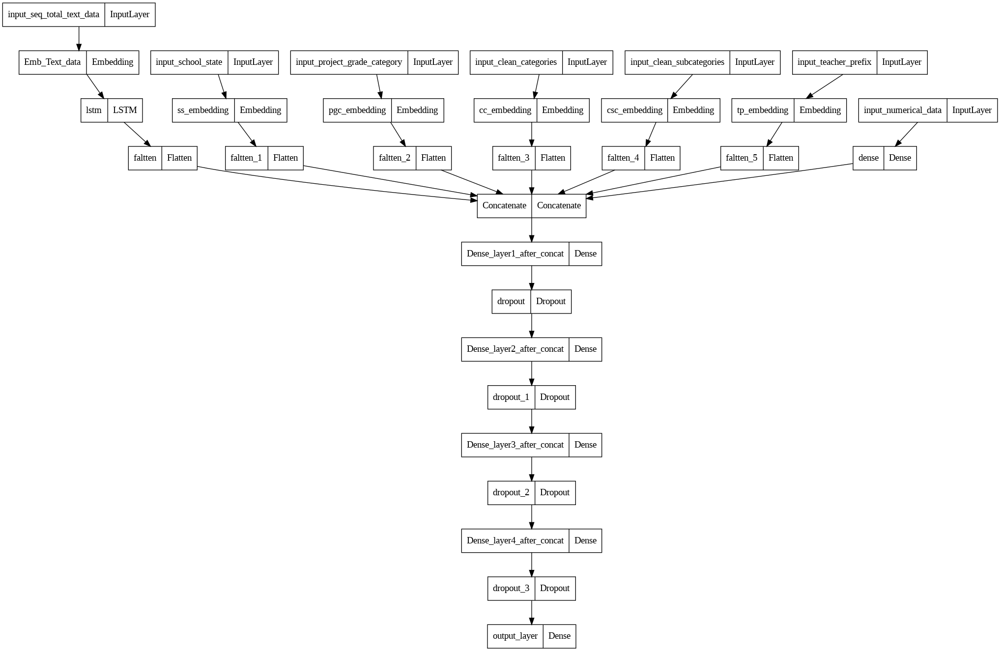

In [ ]:
tf.keras.utils.plot_model(model)

## 1.5 Compiling and fititng your model - Target AUC - 0.75

In [ ]:
from sklearn.metrics import roc_auc_score

In [ ]:
def auc_2(y_true, y_pred):
    # Check for class imbalance first and then return the value counts
      return tf.py_function(roc_auc_score, (y_true, y_pred), tf.double)

In [ ]:
# seed = np.random.randint(1,1000)
def schedule(epoch):

  initial_lr = 0.001
  # This schedule is very specific to the problem that we are dealing here. Its kind of like a step decay function
  if (epoch+1)>=40:
    lr = initial_lr/100
    return lr
  elif (epoch+1)>=25:
    lr = initial_lr/10
    return lr
  
  return initial_lr

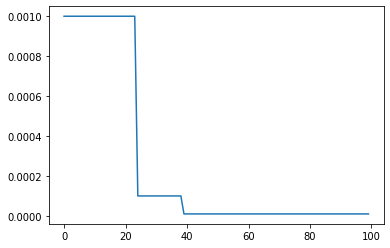

In [ ]:
lrs = []
for i in range(100):
  lrs.append(schedule(i))

plt.plot(lrs)

In [ ]:
# Define parameters, compile model, and then fit model
seed = 663
parameters = {'lstm_units': 100,'dense_layers':[128, 64, 4], 'dense_activation':'relu', 'numerical_dense':3 ,'numerical_activation':'relu',
              'dlac_kerinit':tf.keras.initializers.glorot_normal(seed=seed), 'num_kerinit':tf.keras.initializers.he_normal(seed=seed), 'seed':seed}

model = create_model(parameters)

log_dir = os.path.join("logs",'fits', 'sjm-Model_1-'+datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1,write_graph=False)

train_data = [train_padded, ss_train_sequences, pgc_train_sequences, cc_train_sequences, csc_train_sequences, tp_train_sequences, numerical_data_train]
test_data = [test_padded, ss_test_sequences, pgc_test_sequences, cc_test_sequences, csc_test_sequences, tp_test_sequences, numerical_data_test]


model.compile(loss=tf.keras.losses.BinaryCrossentropy(), 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), 
              metrics=["accuracy", auc_2])

deacy_LR = tf.keras.callbacks.LearningRateScheduler(schedule)

model.fit(train_data,y_train,
              batch_size=128,
          validation_split=0.15,
          initial_epoch=0,
          epochs=50,
          callbacks=[deacy_LR, tensorboard_callback])

Epoch 1/50
653/653 [==============================] - 38s 52ms/step - loss: 0.4361 - accuracy: 0.8485 - auc_2: 0.5681 - val_loss: 0.4164 - val_accuracy: 0.8469 - val_auc_2: 0.6201 - lr: 0.0010
Epoch 2/50
653/653 [==============================] - 32s 49ms/step - loss: 0.4248 - accuracy: 0.8489 - auc_2: 0.5898 - val_loss: 0.4172 - val_accuracy: 0.8469 - val_auc_2: 0.6192 - lr: 0.0010
Epoch 3/50
653/653 [==============================] - 30s 46ms/step - loss: 0.4201 - accuracy: 0.8489 - auc_2: 0.6008 - val_loss: 0.4167 - val_accuracy: 0.8469 - val_auc_2: 0.6216 - lr: 0.0010
Epoch 4/50
653/653 [==============================] - 31s 47ms/step - loss: 0.4179 - accuracy: 0.8489 - auc_2: 0.6039 - val_loss: 0.4170 - val_accuracy: 0.8469 - val_auc_2: 0.6229 - lr: 0.0010
Epoch 5/50
653/653 [==============================] - 29s 45ms/step - loss: 0.4153 - accuracy: 0.8489 - auc_2: 0.6140 - val_loss: 0.4162 - val_accuracy: 0.8469 - val_auc_2: 0.6239 - lr: 0.0010
Epoch 6/50
653/653 [===============

KeyboardInterrupt: ignored

# Terminated train manually at the 24th epoch


In [ ]:
model.evaluate(test_data, y_test, batch_size=128)

86/86 [==============================] - 1s 15ms/step - loss: 0.3629 - accuracy: 0.8577 - auc_2: 0.7594


[0.36290648579597473, 0.8576658964157104, 0.7594184279441833]

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/fits


<IPython.core.display.Javascript object>

# <font color='red'> Model-2 </font>

Using the same model as above but for 'input_seq_total_text_data' we are going to pass only some words in the sentence not all the words. We are going to filter the words as below. 

In [ ]:
vectorizer = TfidfVectorizer()
vectorizer.fit(X_train['essay'].values)

TfidfVectorizer()

In [ ]:
words = vectorizer.get_feature_names_out()  # Store the words

# Store the idf values for the words
idf_words = vectorizer.idf_
len(idf_words)

53984

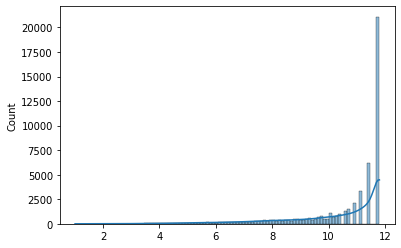

In [ ]:
import seaborn as sns
sns.histplot(idf_words, kde=True)

In [ ]:
# If we refer to the definition of IDF: it is log(N/ni) where ni says how many times the word i occurs across all the documents. 
# For less frequent words this value will be small but for more occuring words this value will be large.
# By simple analysis the more frequent as well as the less frequent words may not be that useful.
# So we'll filter the words are in the idf range of 2-11

In [ ]:
# Here we are storing the words which have idf values in the range 2-11(inclusive). 
new_vocab = []
new_idf_vals = []
for word,idf in zip(words,idf_words):
  if 2<=idf<=11:
    new_vocab.append(word)
    new_idf_vals.append(idf)

In [ ]:
# No of words in total in the new vocabulary
len(new_vocab), len(new_idf_vals)

(23361, 23361)

In [ ]:
# Here we are storing the words that are not within the IDF range of 2-11
words_to_be_removed = list(set(words).difference(set(new_vocab)))
words_to_be_removed.sort()

In [ ]:
# Defining a function which takes in a sentence and removes the words that are not in the new_vocabulary
def words_remover(x, words_to_be_removed=words_to_be_removed):
  for word in words_to_be_removed:
    x = x.replace(' '+word+' ',' ')
  
  return x

In [ ]:
from tqdm import tqdm

In [ ]:
# Removing the words from the train essay column and saving it
sentences = []

for sentence in tqdm(X_train['essay'].values):
  sentences.append(words_remover(sentence))

X_train['new_essay'] = sentences
X_train['y'] = y_train

# Saving so that we can reuse it later without having to run this step again
X_train.to_csv('/content/drive/MyDrive/AAIC_Assignments/train_lstm_model2.csv')

100%|██████████| 98323/98323 [1:12:03<00:00, 22.74it/s]


In [ ]:
# Removing the words from the test essay column and saving it
sentences_test = []
for sentence in tqdm(X_test['essay'].values):
  sentences_test.append(words_remover(sentence))

X_test['new_essay'] = sentences_test
X_test['y'] = y_test

# Saving so that we can reuse it later without having to run this step again
X_test.to_csv('/content/drive/MyDrive/AAIC_Assignments/test_lstm_model2.csv')

100%|██████████| 10925/10925 [07:43<00:00, 23.57it/s]


In [ ]:
# # load the the saved train and test data
X_train = pd.read_csv('/content/drive/MyDrive/AAIC_Assignments/train_lstm_model2.csv')
X_test = pd.read_csv('/content/drive/MyDrive/AAIC_Assignments/test_lstm_model2.csv')

y_train = X_train['y']
y_test = X_test['y']

## Preview of what is to be expected

In [ ]:
X_train['essay'][49535]

'i 32 students 4th grade class 16 boys 16 girls they full enthusiasm curiosity learn world all students love reading exploring new things they families value education actively involved various educational activities learning community each students set high goals new school year expresses interests helping getting involved community service projects they certainly leaders student led learning projects sustainability and society future leaders sustainable world my students engaged school green team monitoring recyclables school conducting weekly bin check around whole school building make sure everybody recycling right they participating nation wide trex challenges monitor school collection recycled plastics every month need collect plastics different classrooms weigh bags report total weight website at time students take care school gardens planting watering plants all activities integrated in math environmental science projects also need compasses constructing geometric figures nanna

In [ ]:
words_remover(X_train['essay'][49535])

'i 32 4th grade 16 boys 16 girls full enthusiasm curiosity world all reading exploring new things families value education actively involved various educational activities community each set high goals new year expresses interests helping getting involved community service projects certainly leaders student led projects sustainability and society future leaders sustainable world engaged green team monitoring recyclables conducting weekly bin check around whole building sure everybody recycling right participating nation wide challenges monitor collection recycled plastics every month collect plastics different classrooms weigh bags report total weight website at time take care gardens planting watering plants all activities integrated in math environmental science projects compasses constructing geometric figures nannan'

In [ ]:
X_train['new_essay'][49535]

'i 32 4th grade 16 boys 16 girls full enthusiasm curiosity world all reading exploring new things families value education actively involved various educational activities community each set high goals new year expresses interests helping getting involved community service projects certainly leaders student led projects sustainability and society future leaders sustainable world engaged green team monitoring recyclables conducting weekly bin check around whole building sure everybody recycling right participating nation wide challenges monitor collection recycled plastics every month collect plastics different classrooms weigh bags report total weight website at time take care gardens planting watering plants all activities integrated in math environmental science projects compasses constructing geometric figures nannan'

In [ ]:
# ************************************ TOKENIZATION ************************************
# Get the maximum length of the essay feature, this will be the input dimension in the network

# This will be required for padding
input_text_dim_1 = max([len(x.split(' ')) for x in X_train['new_essay']])

oov_token = '<UNK>'          # Defining an oov token to be used for words that are not in train data but present in test data

# Initialize the tokenizer and fit it to the train data essays
essay_tokenizer_1 = Tokenizer(oov_token=oov_token)
essay_tokenizer_1.fit_on_texts(X_train['new_essay'])

# get the word indices for each word, this will be useful when using the predefined glove vectors
word_index_1 = essay_tokenizer_1.word_index

# Convert the train essay to sequence of numbers using the tokenizer 
train_essay_sequences_1 = essay_tokenizer_1.texts_to_sequences(X_train['new_essay'])
test_essay_sequences_1 = essay_tokenizer_1.texts_to_sequences(X_test['new_essay'])

# Now pad the train and test essay sequences, so that all the data points have same length
train_padded_1 = pad_sequences(train_essay_sequences_1, padding='post', truncating='post', maxlen=input_text_dim_1)
train_padded_1 = np.array(train_padded_1)

test_padded_1 = pad_sequences(test_essay_sequences_1, padding='post', truncating='post', maxlen=input_text_dim_1)
test_padded_1 = np.array(test_padded_1)


vocab_size_1 = len(word_index_1) + 1
print(vocab_size_1, input_text_dim_1)

# from tqdm import tqdm
import pickle

with open('glove_vectors', 'rb') as f:
    glove_model = pickle.load(f)
    glove_words = set(glove_model.keys())

# ********************************************* EMBEDDING *********************************************
#after getting the padded_docs you have to use predefined glove vectors to get 300 dim representation for each word
# we will be storing this data in form of an embedding matrix and will use it while defining our model

# Initializing the embedding matrix
emb_text_dim = 300        # The dimension of the embedded text
text_embedding_matrix_1 = np.zeros((vocab_size_1, emb_text_dim))   # vocab size for the number of rows and 300 as the number of columns

# Now we need to store each of the glove vectors
for word, i in tqdm(word_index_1.items()):
 embedding_vector = glove_model.get(word)
 if embedding_vector is not None:
   text_embedding_matrix_1[i] = embedding_vector

# Defining the embedding layer for the text data and setting the trainable parameter as False
essay_embedding = Embedding(input_dim=vocab_size_1, output_dim=emb_text_dim, weights=[text_embedding_matrix_1], input_length=input_text_dim_1, name='Emb_Text_data', trainable=False)

24522 301


100%|██████████| 24521/24521 [00:00<00:00, 170986.75it/s]


## Create the model, compile and fit it!

In [ ]:
input_text_dim_1 = 301

In [ ]:
def create_model_2(parameters):

    # defining the model architechture
    tf.keras.backend.clear_session()
    # First gathering all the inputs
    # We have already defined the input dimensions above now we'll use those in the Input function
    input_text = Input(shape=(input_text_dim_1, ), name='input_seq_total_text_data')                        # CHANGED to input_text_dim_1 for this model
    ss_input = Input(shape=(ss_input_dim, ), name='input_school_state')
    pgc_input = Input(shape=(pgc_input_dim, ), name='input_project_grade_category')
    cc_input = Input(shape=(cc_input_dim, ), name='input_clean_categories')
    csc_input = Input(shape=(csc_input_dim, ), name='input_clean_subcategories')
    tp_input = Input(shape=(tp_input_dim, ), name='input_teacher_prefix')
    numerical_input = Input(shape=(num_input_dim, ), name='input_numerical_data')


    # defining the embedding layers and passing the input to this layer
    ess = essay_embedding(input_text)
    ss_emb = ss_embedding(ss_input)
    pgc_emb = pgc_embedding(pgc_input)
    cc_emb = cc_embedding(cc_input)
    csc_emb = csc_embedding(csc_input)
    tp_emb = tp_embedding(tp_input)

    # For the numerical inputs we need to add a dense layer
    num_dense = Dense(parameters['numerical_dense'], activation=parameters['numerical_activation'], kernel_initializer=parameters['num_kerinit'])(numerical_input)

    # Adding LSTM units for text data
    lstm_essay = LSTM(parameters['lstm_units'], dropout=0.2, name='lstm')(ess)

    # Flattening all the layers
    flatten = Flatten(name='faltten')(lstm_essay)
    flatten_1 = Flatten(name='faltten_1')(ss_emb)
    flatten_2 = Flatten(name='faltten_2')(pgc_emb)
    flatten_3 = Flatten(name='faltten_3')(cc_emb)
    flatten_4 = Flatten(name='faltten_4')(csc_emb)
    flatten_5 = Flatten(name='faltten_5')(tp_emb)

    # concatenate all the outputs
    # list_of_concats = [flatten, flatten_1, flatten_2, flatten_3, flatten_4, flatten_5, num_dense]
    concat = tf.keras.layers.concatenate(inputs=[flatten, flatten_1,flatten_2,flatten_3,flatten_4,flatten_5, num_dense], name='Concatenate')

    seed = parameters['seed']
    t = 1

    x = Dense(parameters['dense_layers'][0], activation=parameters['dense_activation'], kernel_initializer=parameters['dlac_kerinit'], 
              name='Dense_layer'+str(t)+'_after_concat')(concat)
    x = Dropout(0.2)(x)

    for i in parameters['dense_layers'][1:]:
      # Dense layers after concat
      seed += 2
      t+=1
      # x = BatchNormalization()(x)
      x = Dense(i, activation=parameters['dense_activation'], kernel_initializer=parameters['dlac_kerinit'], 
                name='Dense_layer'+str(t)+'_after_concat')(x)
      x = Dropout(0.2)(x)
      
    output = Dense(1, activation='sigmoid', name='output_layer', kernel_initializer=tf.keras.initializers.glorot_normal(seed=parameters['seed']))(x)

    model = Model(inputs = [input_text, ss_input, pgc_input, cc_input, csc_input, tp_input, numerical_input], outputs=output)

    return model

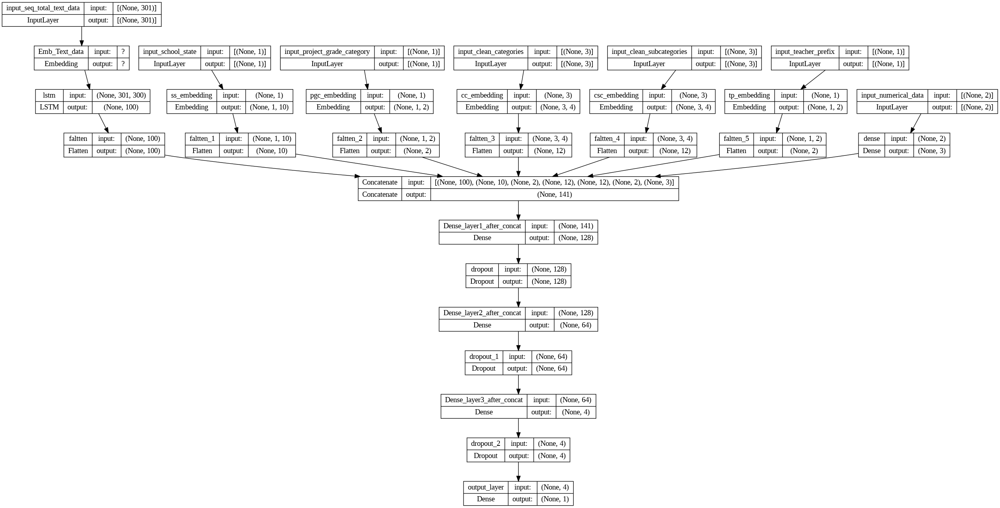

In [ ]:
seed = 663
parameters = {'lstm_units': 100,'dense_layers':[128, 64, 4], 'dense_activation':'relu', 'numerical_dense':3 ,'numerical_activation':'relu',
              'dlac_kerinit':tf.keras.initializers.glorot_normal(seed=seed), 'num_kerinit':tf.keras.initializers.he_normal(seed=seed), 'seed':seed}

model = create_model_2(parameters)
tf.keras.utils.plot_model(model, show_shapes=True)

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_seq_total_text_data (Inp  [(None, 301)]       0           []                               
 utLayer)                                                                                         
                                                                                                  
 Emb_Text_data (Embedding)      (None, 301, 300)     16206600    ['input_seq_total_text_data[0][0]
                                                                 ']                               
                                                                                                  
 input_school_state (InputLayer  [(None, 1)]         0           []                               
 )                                                                                            

In [ ]:
# seed = np.random.randint(1,1000)
def schedule(epoch):

  initial_lr = 0.001
  # This schedule is very specific to the problem that we are dealing here. Its kind of like a step decay function
  if (epoch+1)>=45:
    lr = initial_lr/100
    return lr
  elif (epoch+1)>=30:
    lr = initial_lr/10
    return lr
  
  return initial_lr

In [ ]:
# compile and fit
seed = 663
parameters = {'lstm_units': 100,'dense_layers':[128, 64, 4], 'dense_activation':'relu', 'numerical_dense':3 ,'numerical_activation':'relu',
              'dlac_kerinit':tf.keras.initializers.glorot_normal(seed=seed), 'num_kerinit':tf.keras.initializers.he_normal(seed=seed), 'seed':seed}

model = create_model_2(parameters)

log_dir = os.path.join("logs",'fits', 'sjm-Model_2-'+datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1,write_graph=False)

train_data_1 = [train_padded_1, ss_train_sequences, pgc_train_sequences, cc_train_sequences, csc_train_sequences, tp_train_sequences, numerical_data_train]
test_data_1 = [test_padded_1, ss_test_sequences, pgc_test_sequences, cc_test_sequences, csc_test_sequences, tp_test_sequences, numerical_data_test]


model.compile(loss=tf.keras.losses.BinaryCrossentropy(), 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), 
              metrics=["accuracy", auc_2])

deacy_LR = tf.keras.callbacks.LearningRateScheduler(schedule)

model.fit(train_data_1,y_train,
              batch_size=128,
          validation_split=0.15,
          initial_epoch=0,
          epochs=50,
          callbacks=[deacy_LR, tensorboard_callback])

Epoch 1/50
653/653 [==============================] - 33s 43ms/step - loss: 0.4378 - accuracy: 0.8486 - auc_2: 0.5673 - val_loss: 0.4210 - val_accuracy: 0.8469 - val_auc_2: 0.6221 - lr: 0.0010
Epoch 2/50
653/653 [==============================] - 27s 41ms/step - loss: 0.4250 - accuracy: 0.8489 - auc_2: 0.5920 - val_loss: 0.4170 - val_accuracy: 0.8469 - val_auc_2: 0.6181 - lr: 0.0010
Epoch 3/50
653/653 [==============================] - 24s 37ms/step - loss: 0.4198 - accuracy: 0.8489 - auc_2: 0.6022 - val_loss: 0.4173 - val_accuracy: 0.8469 - val_auc_2: 0.6162 - lr: 0.0010
Epoch 4/50
653/653 [==============================] - 24s 36ms/step - loss: 0.4170 - accuracy: 0.8489 - auc_2: 0.6103 - val_loss: 0.4167 - val_accuracy: 0.8469 - val_auc_2: 0.6197 - lr: 0.0010
Epoch 5/50
653/653 [==============================] - 24s 36ms/step - loss: 0.4145 - accuracy: 0.8489 - auc_2: 0.6173 - val_loss: 0.4171 - val_accuracy: 0.8469 - val_auc_2: 0.6183 - lr: 0.0010
Epoch 6/50
653/653 [===============

In [ ]:
model.evaluate(test_data, y_test, batch_size=128)

86/86 [==============================] - 1s 14ms/step - loss: 0.3733 - accuracy: 0.8529 - auc_2: 0.7460


[0.37325426936149597, 0.8529061675071716, 0.746009886264801]

In [ ]:

%load_ext tensorboard
%tensorboard --logdir logs/fits


<IPython.core.display.Javascript object>

# <font color='red'> Model-3 </font>

<img src='https://i.imgur.com/fkQ8nGo.png'>
ref: https://i.imgur.com/fkQ8nGo.png

In [ ]:
# In this model we will use the text vectorized data from model1 
# for other than text data consider the we are going to follow the following steps
# We will perform one hot encoding of categorical features. We can use onehotencoder() or countvectorizer() for the same.
# Stack up standardised numerical features and all the one hot encoded categorical features
# the input to conv1d layer is 3d, we can convert your 2d data to 3d using np.newaxis
# Note - deep learning models won't work with sparse features, we have to convert them to dense features before fitting in the model.

### Since we cannot use the one hot encoded sparse features we are going to use the response coded values for the categorical features.

In [ ]:
def responseCodingfit(f,y):
    
    '''
    This function returns the response coded values for single feature f based on the class labels.
    This is the fit function which fits the training data to find the response coded values, store them in a dictionary 
    and then return them. It also returns the unique class labels that we have.
    Input :
        f     :   It is the feature for which we want to do the response coding.
        y     :   This is the class labels of the dataset.
        note  :   f,y can be pandas series or list
    Output:
            response,uy
    '''
    
    # We are using pandas dataframe so that we can leverage the filtering techniques of pandas.
    df = pd.DataFrame()                   # Creating a dataframe to store the categorical feature f and the class labels
    df['f'], df['y'] = f, y
    
    uy = df['y'].unique().tolist()       # To store the unique class labels
    uf = df['f'].unique().tolist()       # To store the unique categories of the variable f
    
    # Now we need to create a dictionary in which we will store the probability values for different 
    # combinations of categories and class labels
    
    response = {(f,y):0 for f in uf for y in uy}
    
    # For each combination of class label and category we are counting the number of occurences of pairs of (f,y) 
    # divided by the total number of occurence of f
    for f,y in response:
        response[(f,y)] = len(df[(df['y']==y) & (df['f']==f)])/len(df[df['f']==f])
    
    # Finally we are returning the response encoded probability values based on the train data and 
    # also the class labels(i.e. (0,1) in our case)
    return response,uy

In [ ]:
def responseCodingTransform(f,response,uy):
    
    '''
    This function is to be used only after the 'responseCodingFit' function
    This is only for changing the feature values to the prob.values and then return them as two seperate lists
    Input:
        f        : The feature with categories
        response : The output from the 'responseCodingFit' function
        uy       : The unique class labels avaiable
    Output:
    We are going to return the encoded features as a dataframe
    '''
    
    final_df = pd.DataFrame() # Creating a dataframe to store the final values and return them
    final_df['f'] = f
    
    # Here we are going to iterate over the unique class labels and the assign the values obtained after fitting the data
    # to get the final response coded values. We are also going to take care of the laplace smoothing values.
    for y in uy:
        final_df[str('f_')+str(y)] = final_df['f'].apply(lambda x: response.get((x,y),-1) if response.get((x,y),-1)!=-1 else 1/2)
    
    # Dropping the original categorical feature and returning the response encoded columns.
    final_df.drop(['f'], inplace=True, axis=1)
    return final_df

<h3>3.1 Encoding categorical feature : school_state</h3>

In [ ]:
# First fitting the categorical feature train data 
responses,class_labels = responseCodingfit(X_train['school_state'].values, y_train.values)

X_train_school_state = responseCodingTransform(X_train['school_state'].values,responses,class_labels).values
X_test_school_state = responseCodingTransform(X_test['school_state'].values,responses,class_labels).values

print(X_train_school_state.shape, y_train.shape)
print(X_test_school_state.shape, y_test.shape)
print('='*100)

(98323, 2) (98323,)
(10925, 2) (10925,)



<h3>3.2 Encoding categorical feature : teacher_predfix</h3>

In [ ]:
# First fitting the categorical feature train data 
responses,class_labels = responseCodingfit(X_train['teacher_prefix'].values, y_train.values)

X_train_teacher_prefix = responseCodingTransform(X_train['teacher_prefix'].values,responses,class_labels).values
X_test_teacher_prefix = responseCodingTransform(X_test['teacher_prefix'].values,responses,class_labels).values

print(X_train_teacher_prefix.shape, y_train.shape)
print(X_test_teacher_prefix.shape, y_test.shape)
print('='*100)

(98323, 2) (98323,)
(10925, 2) (10925,)


<h3>3.3 Encoding categorical feature : project_grade_category</h3>

In [ ]:
# First fitting the categorical feature train data 
responses,class_labels = responseCodingfit(X_train['project_grade_category'].values, y_train.values)

X_train_project_grade_category = responseCodingTransform(X_train['project_grade_category'].values,responses,class_labels).values
X_test_project_grade_category = responseCodingTransform(X_test['project_grade_category'].values,responses,class_labels).values

print(X_train_project_grade_category.shape, y_train.shape)
print(X_test_project_grade_category.shape, y_test.shape)
print('='*100)

(98323, 2) (98323,)
(10925, 2) (10925,)


<h3>3.4 Encoding categorical feature : clean_categories</h3>

In [ ]:
# First fitting the categorical feature train data 
responses,class_labels = responseCodingfit(X_train['clean_categories'].values, y_train.values)

X_train_clean_categories = responseCodingTransform(X_train['clean_categories'].values,responses,class_labels).values
X_test_clean_categories = responseCodingTransform(X_test['clean_categories'].values,responses,class_labels).values

print(X_train_clean_categories.shape, y_train.shape)
print(X_test_clean_categories.shape, y_test.shape)
print('='*100)

(98323, 2) (98323,)
(10925, 2) (10925,)


<h3>3.5 Encoding categorical feature : clean_subcategories</h3> 

In [ ]:
# First fitting the categorical feature train data 
responses,class_labels = responseCodingfit(X_train['clean_subcategories'].values, y_train.values)

X_train_clean_subcategories = responseCodingTransform(X_train['clean_subcategories'].values,responses,class_labels).values
X_test_clean_subcategories = responseCodingTransform(X_test['clean_subcategories'].values,responses,class_labels).values

print(X_train_clean_subcategories.shape, y_train.shape)
print(X_test_clean_subcategories.shape, y_test.shape)
print('='*100)

(98323, 2) (98323,)
(10925, 2) (10925,)


## Preparing the data for input

In [ ]:
# Stack all the other features other than the text data
train_stack = np.hstack([X_train_school_state, X_train_teacher_prefix, X_train_project_grade_category, X_train_clean_categories,X_train_clean_subcategories, 
                         tnopp_train, price_train])

test_stack = np.hstack([X_test_school_state, X_test_teacher_prefix, X_test_project_grade_category, X_test_clean_categories, X_test_clean_subcategories, 
                         tnopp_test, price_test])

print(train_stack.shape)
print(test_stack.shape)

(98323, 12)
(10925, 12)


In [ ]:
## the input to conv1d layer is 3d, you can convert your 2d data to 3d using np.newaxis
# adding a new_axis to the data
train_stack = train_stack[:,:,np.newaxis]
test_stack = test_stack[:,:,np.newaxis]

In [ ]:
stack_input_dim = train_stack.shape[1:]
stack_input_dim

(12, 1)

In [ ]:
from tensorflow.keras.layers import Conv1D

# Create the model

In [ ]:
# tf.keras.layers.Conv1D(
#     filters,
#     kernel_size,
#     strides=1,
#     padding='valid',
#     data_format='channels_last',
#     dilation_rate=1,
#     groups=1,
#     activation=None,
#     use_bias=True,
#     kernel_initializer='glorot_uniform',
#     bias_initializer='zeros',
#     kernel_regularizer=None,
#     bias_regularizer=None,
#     activity_regularizer=None,
#     kernel_constraint=None,
#     bias_constraint=None,
#     **kwargs
# )

In [ ]:
def create_model_3(parameters):

    # defining the model architechture
    tf.keras.backend.clear_session()
    
    # First gathering all the inputs
    # We have already defined the input dimensions above now we'll use those in the Input function
    input_text = Input(shape=(input_text_dim, ), name='input_seq_total_text_data')                        # CHANGED to input_text_dim for this model. SAME as model-1
    conv_1_input = Input(shape=(stack_input_dim[0],stack_input_dim[1], ))


    # defining the embedding layers and passing the input to this layer
    ess = essay_embedding(input_text)
    conv1D_1 = Conv1D(filters=parameters['conv1d_1_num_f'], kernel_size=3, activation='relu', kernel_initializer=parameters['conv1d_1_kerinit'], name='Conv1D_1')(conv_1_input)
    conv1D_2 = Conv1D(filters=parameters['conv1d_2_num_f'], kernel_size=3, activation='relu', kernel_initializer=parameters['conv1d_2_kerinit'], name='Conv1D_2')(conv1D_1)

    # Adding LSTM units for text data
    lstm_essay = LSTM(parameters['lstm_units'], dropout=0.2, name='lstm')(ess)

    # Flattening all the layers
    flatten = Flatten(name='faltten')(lstm_essay)
    flatten_1 = Flatten(name='faltten_1')(conv1D_2)

    # concatenate all the outputs
    # list_of_concats = [flatten, flatten_1, flatten_2, flatten_3, flatten_4, flatten_5, num_dense]
    concat = tf.keras.layers.concatenate(inputs=[flatten, flatten_1], name='Concatenate')

    seed = parameters['seed']
    t = 1

    x = Dense(parameters['dense_layers'][0], activation=parameters['dense_activation'], kernel_initializer=parameters['dlac_kerinit'], 
              name='Dense_layer'+str(t)+'_after_concat')(concat)
    x = Dropout(0.2)(x)

    for i in parameters['dense_layers'][1:]:
      # Dense layers after concat
      t+=1
      # x = BatchNormalization()(x)
      x = Dense(i, activation=parameters['dense_activation'], kernel_initializer=parameters['dlac_kerinit'], 
                name='Dense_layer'+str(t)+'_after_concat')(x)
      x = Dropout(0.2)(x)
      
    output = Dense(1, activation='sigmoid', name='output_layer', kernel_initializer=tf.keras.initializers.glorot_normal(seed=parameters['seed']))(x)

    model = Model(inputs = [input_text, conv_1_input], outputs=output)

    return model

In [ ]:
seed = 663
parameters = {'lstm_units': 100,'dense_layers':[128, 64, 4], 'conv1d_1_num_f':8 ,'conv1d_2_num_f': 4 , 'dense_activation':'relu', 'conv1d_1_kerinit': tf.keras.initializers.he_normal(seed=seed),
              'conv1d_2_kerinit':tf.keras.initializers.he_uniform(seed=seed) ,'dlac_kerinit':tf.keras.initializers.glorot_normal(seed=seed), 'seed':seed}

model = create_model_3(parameters)
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_seq_total_text_data (Inp  [(None, 339)]       0           []                               
 utLayer)                                                                                         
                                                                                                  
 input_1 (InputLayer)           [(None, 12, 1)]      0           []                               
                                                                                                  
 Emb_Text_data (Embedding)      multiple             16206600    ['input_seq_total_text_data[0][0]
                                                                 ']                               
                                                                                              

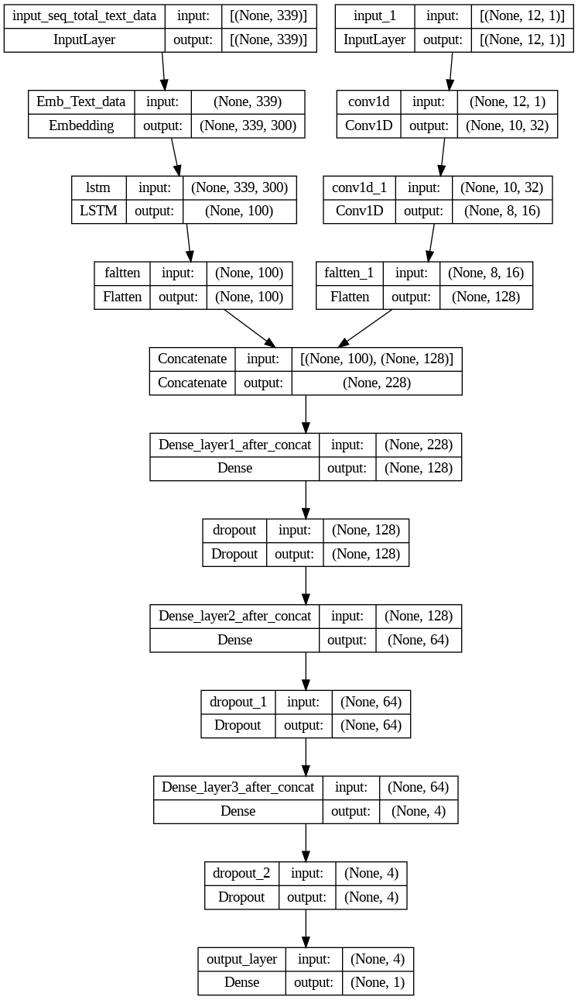

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True)

# Fit and Compile the model

In [ ]:
log_dir = os.path.join("logs",'fits', 'sjm-Model_3-'+datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir,histogram_freq=1,write_graph=False)

# Preparing the input for the model
train_data = [train_padded, train_stack]
test_data = [test_padded, test_stack]

# Compile the model
model.compile(loss=tf.keras.losses.BinaryCrossentropy(), 
              optimizer=tf.keras.optimizers.Adam(learning_rate=0.001), 
              metrics=["accuracy", auc_2])

# deacy_LR = tf.keras.callbacks.LearningRateScheduler(schedule_2)

# Fit the model
model.fit(train_data,y_train,
              batch_size=128,
          validation_split=0.15,
          initial_epoch=0,
          epochs=50,
          callbacks=[tensorboard_callback])

Epoch 1/50
653/653 [==============================] - 42s 44ms/step - loss: 0.4382 - accuracy: 0.8486 - auc_2: 0.5560 - val_loss: 0.4154 - val_accuracy: 0.8469 - val_auc_2: 0.6296
Epoch 2/50
653/653 [==============================] - 29s 44ms/step - loss: 0.4260 - accuracy: 0.8489 - auc_2: 0.5864 - val_loss: 0.4142 - val_accuracy: 0.8469 - val_auc_2: 0.6307
Epoch 3/50
653/653 [==============================] - 28s 43ms/step - loss: 0.4198 - accuracy: 0.8489 - auc_2: 0.6028 - val_loss: 0.4145 - val_accuracy: 0.8469 - val_auc_2: 0.6307
Epoch 4/50
653/653 [==============================] - 29s 45ms/step - loss: 0.4181 - accuracy: 0.8489 - auc_2: 0.6030 - val_loss: 0.4144 - val_accuracy: 0.8469 - val_auc_2: 0.6324
Epoch 5/50
653/653 [==============================] - 28s 43ms/step - loss: 0.4161 - accuracy: 0.8489 - auc_2: 0.6106 - val_loss: 0.4142 - val_accuracy: 0.8469 - val_auc_2: 0.6317
Epoch 6/50
653/653 [==============================] - 29s 44ms/step - loss: 0.4147 - accuracy: 0.848

In [ ]:
model.evaluate(test_data, y_test, batch_size=128)

86/86 [==============================] - 2s 27ms/step - loss: 0.4136 - accuracy: 0.8421 - auc_2: 0.7202


[0.4135574698448181, 0.8421052694320679, 0.7201743721961975]

In [ ]:
%load_ext tensorboard
%tensorboard --logdir logs/fits

<IPython.core.display.Javascript object>